<a href="https://colab.research.google.com/github/Amine-OMRI/CV_Parsing/blob/Fadel492-patch-1/01_Best_rotation_using_easyocr.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [ ]:
import easyocr
import PIL
import matplotlib.patches as patches
import numpy as np
import matplotlib.pyplot as plt
import math
from tqdm import tqdm
import pandas as pd
import pickle

In [ ]:
data_folder = "data/"

# Loading EasyOCR reader

In [ ]:
reader = easyocr.Reader(['fr','en']) # need to run only once to load model into memory

# Test files

## Clean and steady

My old CV, clean, directly from a pdf file, and its text.

In [ ]:
test_img = PIL.Image.open(f"{data_folder}difficult_original.png")
with open(f"{data_folder}difficult_original_text.txt", "rt", encoding="UTF-8") as f:
    original_text = f.read()

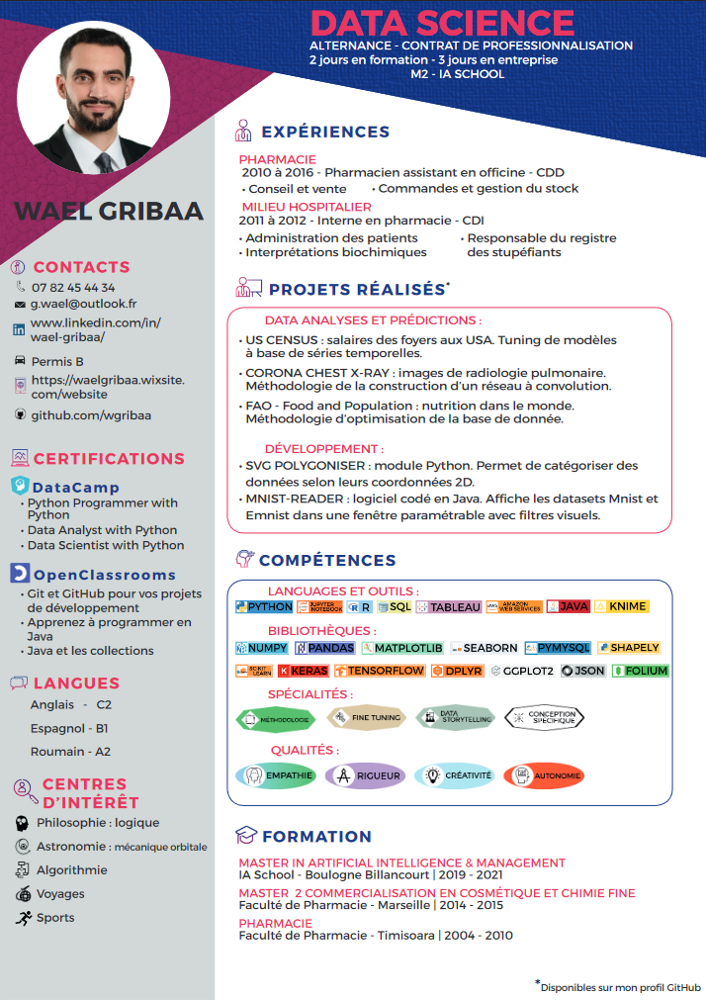

In [ ]:
test_img

In [ ]:
print(original_text)

DATA SCIENCE CONTRAT D’ALTERNANCE / STAGE MI-TEMPS
2 jours en formation - 3 jours en entreprise
M2 - IA SCHOOL
FORMATION
MASTER IN ARTIFICIAL INTELLIGENCE & MANAGEMENT
PROJETS RÉALISÉS
PERSONNEL
2018 - Réseau neuronal et POO
• Développement d’un Feedforward NN en Java sans package externe
• Développement d’un visualiseur des données de Mnist et Emnist
DATA SCIENCE
2019 - IA School et certifications en ligne
• Prédiction des prix d’AirBnb de New York (orienté business)
• Analyse complète des tendances Youtube françaises
• Prédiction de la valeur des footballeurs de la Fifa
CENTRES D’INTÉRÊTS
INFORMATIONS
Permis B
07 82 45 44 34
g.wael@outlook.fr
www.linkedin.com/in/
wael-gribaa/
https://waelgribaa.wixsite.
com/website
github.com/wgribaa
COMPÉTENCES
PYTHON
JAVA
SQL
EXCEL
LANGUES
Anglais
Espagnol
Roumain
• Philosophie : Logique
aristotélicienne
• Astronomie : mécaniques
orbitales
• POO : Design patterns
• Voyages : Canada - Europe
- Afrique du Nord
• Sport : Callisthénie (2ans),
Badminton

## Difficult picture

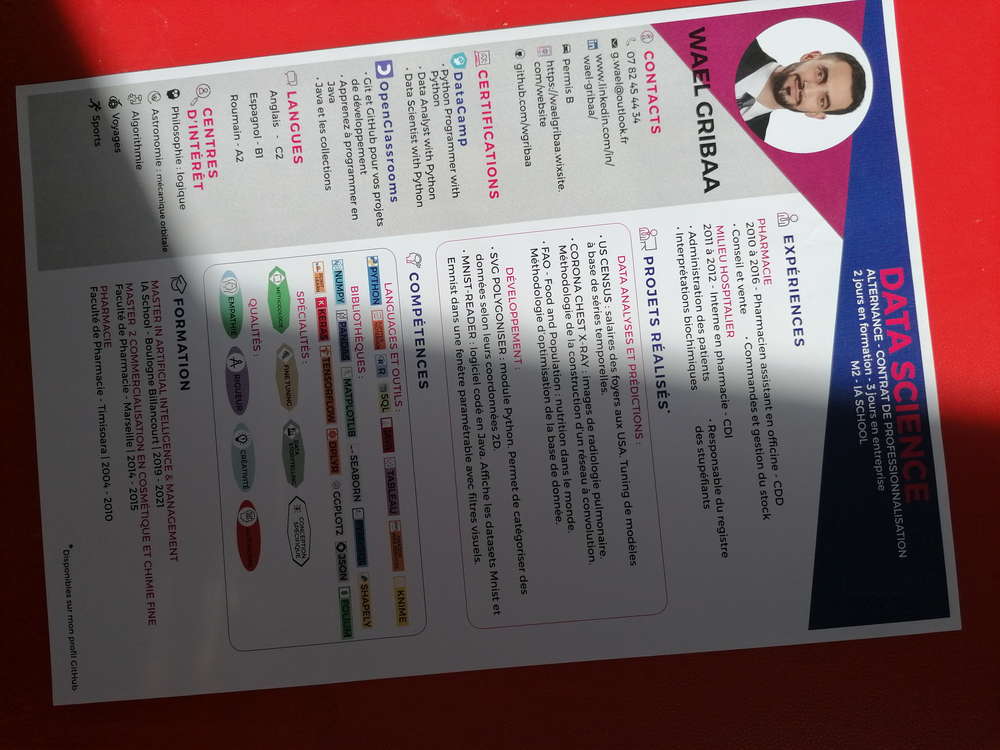

In [ ]:
diff_img = PIL.Image.open("cv_difficult.jpg")
diff_img

# Predictions

## Helper functions

In [ ]:
def agg_confidence(results: list) -> float:
    """
    We want the best mean and the max text length per prediction. Old formula, doesn't work.
    """
#     all_rot["mean_confidence"] * all_rot["mean_diagonal_size"] * all_rot["mean_sentence_length"]
    mean_conf = np.mean([r[2] for r in results])
    mean_diag_size = np.mean([((r[0][0][0] - r[0][2][0]) ** 2 + (r[0][0][1] - r[0][2][1]) ** 2) ** 0.5 for r in results])
    mean_sentence_length = np.mean([len(r[1]) for r in results])
    return mean_conf * mean_diag_size * mean_sentence_length

def show_bboxes(result, img, cmap="brg"):
    """
    Shows the image with predicted bboxes, text and confidence.
    High definition to better read labels.
    """
    fig, ax = plt.subplots(figsize=(32, 32))
    ax.imshow(img)
    cmap = plt.get_cmap(cmap)
    for bbox, text, conf in result:
        color = cmap(conf)
        h = bbox[1][0] - bbox[0][0]
        w = bbox[2][1] - bbox[0][1]
        rect = patches.Rectangle(bbox[0], h, w, linewidth=0.5, edgecolor=color, facecolor="none")
        ax.add_patch(rect)
        ax.text(bbox[0][0], bbox[0][1]-2.5, f"{text} : {conf:.2f}", fontsize=12, color=color)
    ax.axis(False)
    plt.show()
    
def predict(img, show=True):
    """
    Returns the prediction in original format : tuple(bboxes, text, confidence).
    """
    pred_ = reader.readtext(np.asarray(img))
    if show:
        print(f"Total confidence = {agg_confidence(pred_)}.")
        show_bboxes(pred_, img)
    return pred_


Default cmap


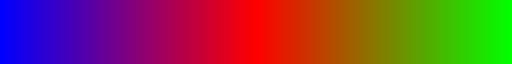

In [ ]:
print("Default cmap")
display(plt.get_cmap("brg"))

## Predicting and visualizing

Clean image
Total confidence = 1385.9073030601198.


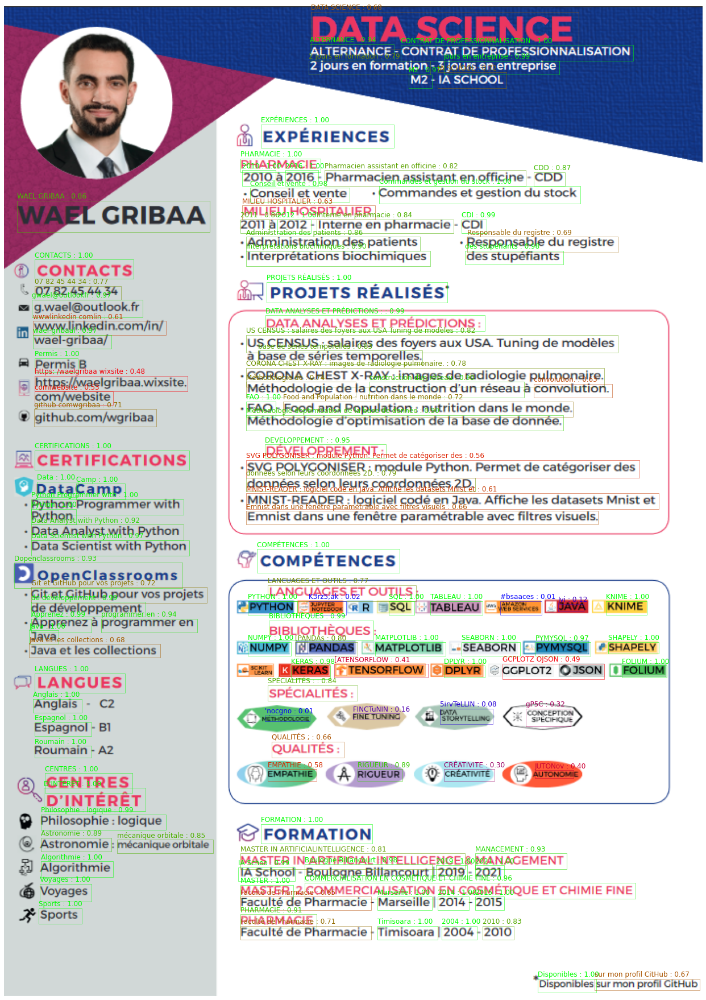

In [ ]:
print("Clean image")
pred_test_img = predict(test_img)

Difficult image
Total confidence = 97.32035331108335.


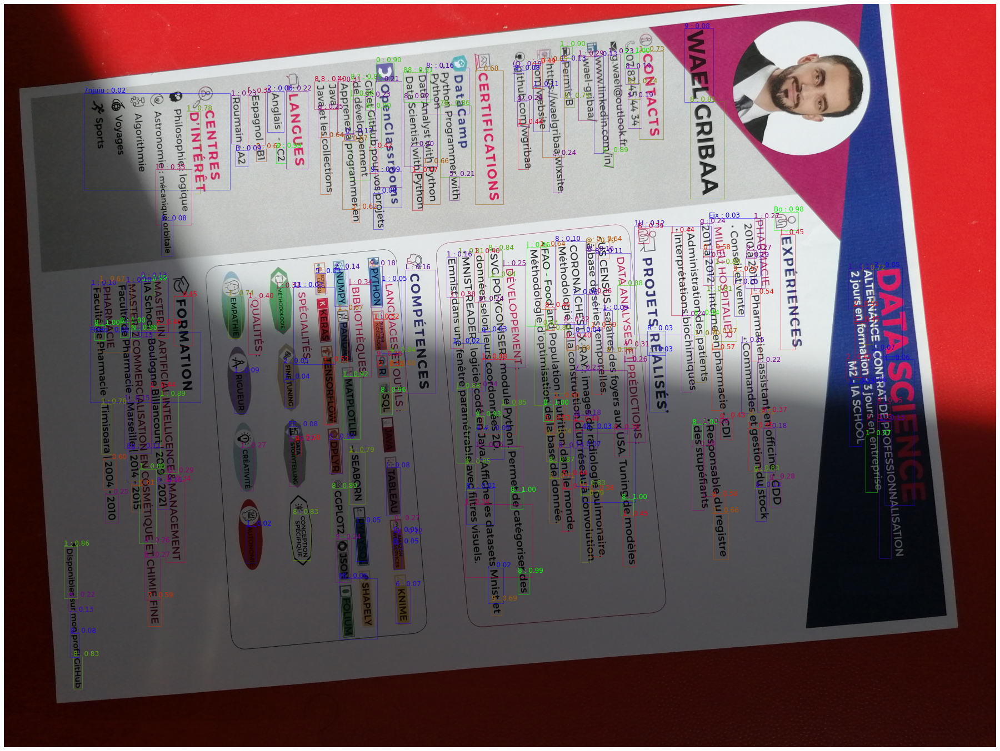

In [ ]:
print("Difficult image")
pred_diff_img = predict(diff_img)

# Goal #1: Get results from the diff_image close to the test_img

## Solution 1 : Rotate

### Rotate broadly

In [ ]:
def best_rotation(img: PIL.Image, first_result: list = None, show_best: bool = True) -> tuple:
    """
    Rotates the image 3 or 4 times, to have each 90° rotations,
    and returns the value of the rotation angle that gave the best score.
    
    :param first_result: A similarly formatted result. If passed, it will assule it is the result of "angle 0"
    and won't need to calculate this angle.
    :return: A tuple containing information about the best result :
        - its angle or rotation relative to thej original passed Image.
        - its score (aggregated confidence).
        - the result from easyocr.
    """
    # no need to recompute the angle=0 if given.
    result = predict(img, False) if first_result is None else first_result
    # best_result is (angle//90, total_conf, result, image)
    best_result = 0, agg_confidence(result), result, img
    
    for angle in range(90, 4*90, 90):
        img_r = img.rotate(angle, expand=True)
        result = predict(img_r, False)
        conf = agg_confidence(result)
        if conf > best_result[1]:
            best_result = angle, conf, result, img_r
            
    print(f"Best broad rotation is {angle}°.")    
    
    if show_best:
        print(f"Total Confidence = {best_result[1]}.")
        show_bboxes(*best_result[2:])
        
    return best_result[:3]

Best broad rotation is 270°.
Total Confidence = 757.6562486718743.


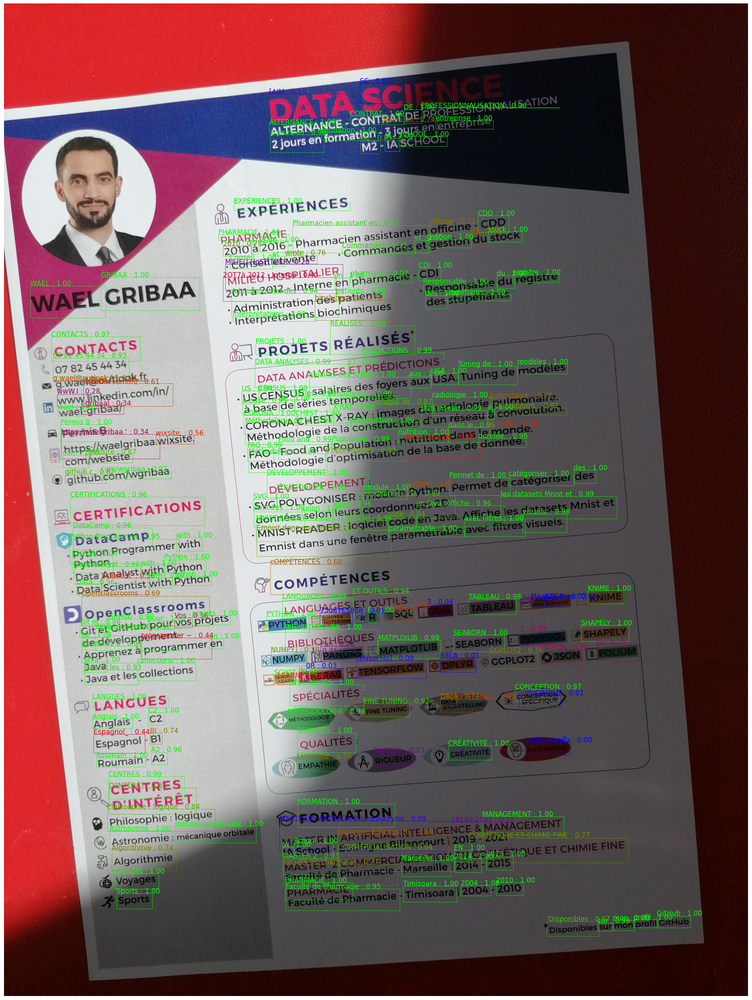

In [ ]:
best_broad = best_rotation(diff_img)

## Rotate more precisely

In [ ]:
def best_fine_rotation(img: PIL.Image, first_result: list = None, show_best: bool = True,
                       max_precision: float = None, max_iterations: int = None, max_delta_angle: float = None) -> tuple:
    
    def max_result(result1, result2):
        return (result1, result1[0]<result2[0] )if result1[1] > result2[1] else (result2, result2[0]<result1[0])
    
    if max_precision is None:
        if max_iterations is None:
            if max_delta_angle is None:
                max_delta_angle = 1
        else:
            max_delta_angle = 180.*2**-max_iterations
    else:
        if max_precision >=1:
            max_delta_angle = 3.6 * max_precision
        else:
            max_delta_angle = 360 * max_precision
    
    
    print(f"max_delta_angle set to {max_delta_angle} == {math.ceil(math.log(180/max_delta_angle)/math.log(2))} iterations.")
    
    # First 4 are necessarily outside the loop for the first comparison.
    
    
    # result_report_n are (angle, total_conf, result, image)
    
    # We don't need to process the original image again if the result was provided
    result1 = predict(img, False) if first_result is None else first_result
    result1 = 0, agg_confidence(result1), result1, img
    
    img_2 = img.rotate(180)
    result2 = predict(img.rotate(180, expand=True), False)
    result2 = 180, agg_confidence(result2), result2, img_2

    best_result, more = max_result(result1, result2)
    
    del result1, result2
    
    delta_angle = 180
    
    while delta_angle >= max_delta_angle:
        delta_angle /= 2
        next_angle = (best_result[0] + (more * 2 - 1) * delta_angle) % 360
        
        print(f"Comparing angles {next_angle} and {best_result[0]}.")
        
        img_r = img.rotate(next_angle, expand=True)
        
        result = predict(img_r, False)
        result = next_angle, agg_confidence(result), result, img_r
        print(f"{next_angle} got {result[1]} while {best_result[0]} had {best_result[1]}.")
        best_result, more = max_result(best_result, result)


    print(f"Best fine rotation is {best_result[0]}°.")
    
    show_bboxes(*best_result[2:])
    return best_result[:3]

max_delta_angle set to 1 == 8 iterations.
Comparing angles 90.0 and 0.
90.0 got 757.6562486718743 while 0 had 426.4632598198642.
Comparing angles 45.0 and 90.0.
45.0 got 826.3643231139414 while 90.0 had 757.6562486718743.
Comparing angles 67.5 and 45.0.
67.5 got 1009.6088515283067 while 45.0 had 826.3643231139414.
Comparing angles 56.25 and 67.5.
56.25 got 933.9838731132505 while 67.5 had 1009.6088515283067.
Comparing angles 61.875 and 67.5.
61.875 got 987.0817398263533 while 67.5 had 1009.6088515283067.
Comparing angles 64.6875 and 67.5.
64.6875 got 993.9103226023315 while 67.5 had 1009.6088515283067.
Comparing angles 66.09375 and 67.5.
66.09375 got 1002.9657370759304 while 67.5 had 1009.6088515283067.
Comparing angles 66.796875 and 67.5.
66.796875 got 1011.9239111281285 while 67.5 had 1009.6088515283067.
Best fine rotation is 66.796875°.


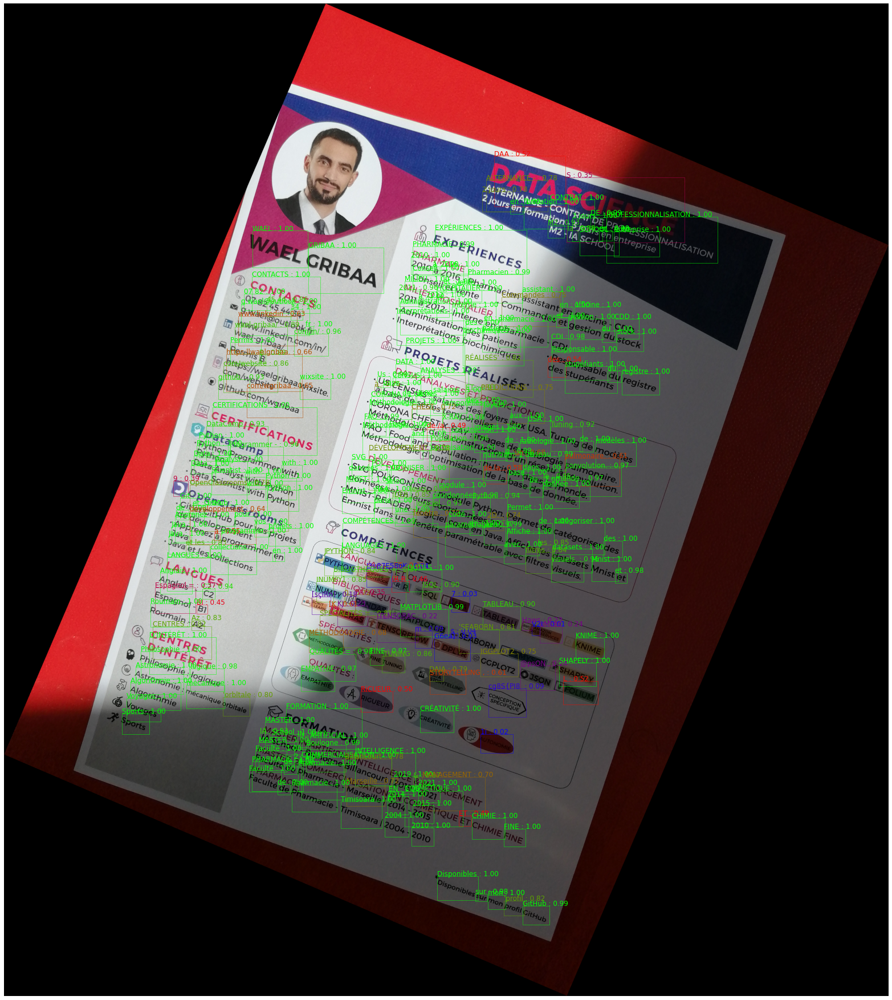

In [ ]:
best_fine = best_fine_rotation(diff_img, pred_diff_img)

## Manually rotated

In [ ]:
diff_fine_rotated = diff_img.rotate(84, expand=True)

In [ ]:
result_fine_rotated = reader.readtext(np.asarray(diff_fine_rotated))

In [ ]:
print(f"Total confidence : {agg_confidence(result_fine_rotated)}.")

Total confidence : 453.1305383560586.


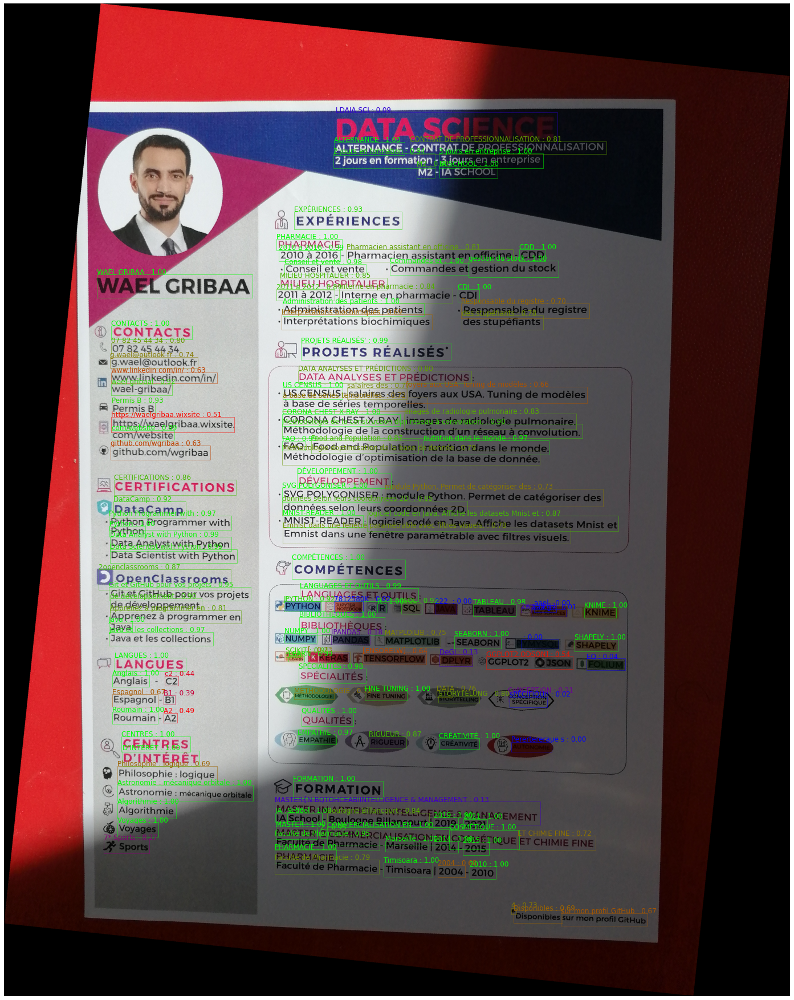

In [ ]:
show_bboxes(result_fine_rotated, diff_fine_rotated)

# All rotations

Difficult image
Total confidence = 97.32035331108335.


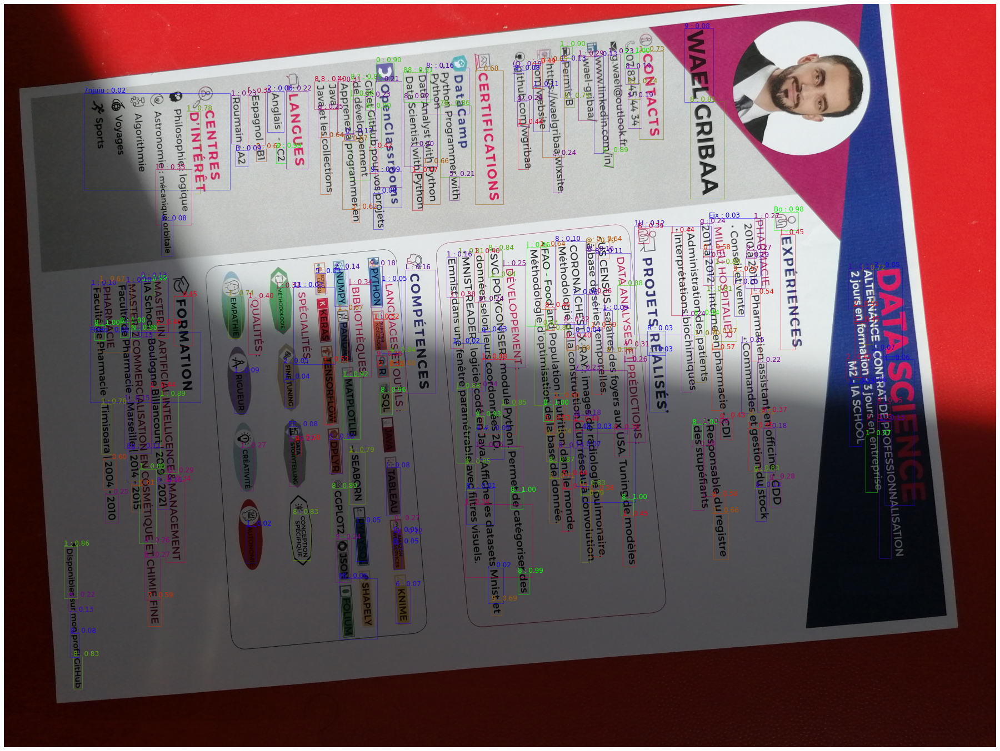

In [ ]:
print("Difficult image")
pred_diff_img = predict(diff_img)

In [ ]:
def all_rotations(img: PIL.Image, first_result: list = None, delta_angle: float = 2.5) -> tuple:
    """
    Rotates the image by delta_angle until it does a complete turn (360°) and predict all the images rotated.
    Simply returns the results, not the aggregated confidence."""
    # no need to recompute the angle=0 if given.
    result = predict(img, False) if first_result is None else first_result
    # best_result is (angle//90, total_conf, result, image)
    best_result = 0, agg_confidence(result), result, img
    
    results = []
    
    n_rotations = math.ceil(360/delta_angle)
    for i in tqdm(range(1, n_rotations), total=n_rotations-1):
        angle = i*delta_angle
        img_r = img.rotate(angle, expand=True)
        results.append({"angle": angle, "result": predict(img_r, False)})
            
        
    return results

def show_best_by_column(dataframe: pd.DataFrame, n_best: int = 5):
    for col in dataframe.columns:
        print("Best rotations for "+col)
        display(dataframe.sort_values(col, ascending=False). head(n_best))
        print("\n\n")

In [ ]:
res = all_rotations(diff_img, first_result=pred_diff_img, delta_angle=2.5)


100%|██████████| 143/143 [11:10<00:00,  4.69s/it]


In [ ]:
res[0]["result"]

[([[2251, 248], [2292, 248], [2292, 293], [2251, 293]],
  '1',
  0.23105886727456948),
 ([[2508, 263], [2558, 263], [2558, 329], [2508, 329]],
  '9',
  0.9809681094907461),
 ([[2187, 310], [2240, 310], [2240, 447], [2187, 447]],
  '1',
  0.15323647621088643),
 ([[2517, 324], [2567, 324], [2567, 391], [2517, 391]],
  '8',
  0.7436256038643343),
 ([[1409, 413], [1512, 413], [1512, 492], [1409, 492]],
  '8 ?',
  0.8226837209531116),
 ([[1617, 378], [1727, 378], [1727, 501], [1617, 501]],
  '88',
  0.9850172624973841),
 ([[2273, 454], [2315, 454], [2315, 493], [2273, 493]],
  '0',
  0.2554770014739951),
 ([[2527, 386], [2577, 386], [2577, 449], [2527, 449]],
  '51',
  0.48240601524435284),
 ([[1263, 429], [1366, 429], [1366, 544], [1263, 544]],
  '8 8',
  0.47871029262888354),
 ([[1474, 483], [1512, 483], [1512, 538], [1474, 538]],
  '9',
  0.38707618983977454),
 ([[362, 543], [430, 543], [430, 611], [362, 611]], 'y', 0.020809224824208883),
 ([[1283, 542], [1325, 542], [1325, 593], [1283, 

In [ ]:
for re in res:
    x = re["result"][0][0]
    print(x)
    print(((x[0][0]-x[2][0])**2 + (x[0][1] - x[2][1])**2) ** 0.5)
    break

[[2251, 248], [2292, 248], [2292, 293], [2251, 293]]
60.876925020897694


In [ ]:
res[0]["result"][0][0][0][1]

248

In [ ]:
[np.mean([((r[0][0][0] - r[0][2][0]) ** 2 + (r[0][0][1] - r[0][2][1]) ** 2) ** 0.5 for r in rs["result"]]) for rs in res]

[182.68725004000422,
 182.68536482901467,
 183.70208525496795,
 183.92478666389323,
 186.39177592869754,
 185.59744365065828,
 188.11933954072194,
 188.03474104011167,
 189.66403210741254,
 189.7505607238264,
 190.75240218881032,
 189.68140474071964,
 191.41919929890253,
 191.97611858291677,
 189.99619415626415,
 192.73445418762788,
 189.93698959681905,
 190.3222164144429,
 188.09191534842094,
 189.6164417275525,
 185.64750003302086,
 189.35330587653283,
 186.6959239317328,
 187.58632044012637,
 185.48887476747078,
 185.4657251082479,
 183.12819052105846,
 184.8766402411035,
 183.3815335428776,
 182.22691933889323,
 189.14088271257617,
 257.1016618392379,
 329.9816308285391,
 354.62076338052987,
 314.24409524194465,
 230.8226219903994,
 192.41729877240778,
 187.0026733360048,
 186.13220292307338,
 185.8597617956541,
 186.39713233339592,
 183.43664740226674,
 186.82720285786806,
 186.85862094593227,
 185.95018812163235,
 187.83438749762365,
 187.54427674536848,
 183.98997004179384,
 183

In [ ]:
f_res = [{"angle": rs["angle"], 
           "n_boxes": len(rs["result"]),
           "mean_confidence": np.mean([r[2] for r in rs["result"]]),
           "mean_sentence_length": np.mean([len(r[1]) for r in rs["result"]]),
           "mean_height": np.mean([abs(r[0][2][0]-r[0][0][0]) for r in rs["result"]]),
           "mean_width": np.mean([abs(r[0][0][1]-r[0][2][1]) for r in rs["result"]]),
           "mean_diagonal_size": np.mean([((r[0][0][0] - r[0][2][0]) ** 2 + (r[0][0][1] - r[0][2][1]) ** 2) ** 0.5 for r in rs["result"]])}
    for rs in res
]

In [ ]:
pd.DataFrame(f_res).sort_values("mean_diagonal_size", ascending=False).head(10)

,angle,n_boxes,mean_confidence,mean_sentence_length,mean_height,mean_width,mean_diagonal_size
105,265.0,131,0.216428,14.343511,373.213740,55.076336,378.853454
33,85.0,140,0.800043,13.792857,348.578571,54.085714,354.620763
104,262.5,150,0.283822,12.340000,327.719231,63.888297,335.632308
32,82.5,153,0.834854,12.614379,322.003158,63.398004,329.981631
106,267.5,160,0.274834,11.581250,308.887326,63.782433,316.787186
34,87.5,162,0.823089,11.913580,305.921638,64.475846,314.244095
31,80.0,201,0.870533,9.532338,244.912737,71.587331,257.101662
103,260.0,201,0.315609,9.039801,243.616345,72.165168,256.092732
107,270.0,214,0.343346,8.476636,232.504821,56.534646,241.214168
35,90.0,225,0.841840,8.324444,221.527579,58.164932,230.822622


In [ ]:
all_rot = pd.read_csv("all_rotations_formatted_results.csv", index_col=0)

In [ ]:
all_rot

,n_boxes,mean_confidence,mean_sentence_length,mean_height,mean_width,mean_diagonal_size
angle,,,,,,
2.5,282,0.444771,1.060284,65.438793,168.860367,182.687250
5.0,285,0.470985,1.028070,70.787549,167.016515,182.685365
7.5,283,0.458103,1.003534,77.752159,165.374726,183.702085
10.0,284,0.474797,1.028169,84.658510,162.269966,183.924787
12.5,282,0.468942,1.024823,92.625089,160.877542,186.391776
...,...,...,...,...,...,...
347.5,273,0.503970,1.043956,30.084198,184.722407,191.185992
350.0,247,0.478962,1.145749,62.626769,174.272106,190.774376
352.5,217,0.463689,1.221198,77.399030,176.887588,197.740460


In [ ]:
all_rot.loc[[90, 180, 270], :]

,n_boxes,mean_confidence,mean_sentence_length,mean_height,mean_width,mean_diagonal_size,agg_score
angle,,,,,,,
90,225,0.841840,8.324444,221.527579,58.164932,230.822622,1617.570914
180,232,0.446034,1.198276,81.330239,181.093883,202.977175,108.485498
270,214,0.343346,8.476636,232.504821,56.534646,241.214168,702.035016


## Trying many formulas to find the one scoring the best on 82.5 or 85° 

In [ ]:
all_rot["agg_score"] = all_rot["mean_confidence"] * all_rot["mean_diagonal_size"] * all_rot["mean_sentence_length"]
all_rot

,n_boxes,mean_confidence,mean_sentence_length,mean_height,mean_width,mean_diagonal_size,f1,agg_score
angle,,,,,,,,
2.5,282,0.444771,1.060284,65.438793,168.860367,182.687250,86.152329,86.152329
5.0,285,0.470985,1.028070,70.787549,167.016515,182.685365,88.457370,88.457370
7.5,283,0.458103,1.003534,77.752159,165.374726,183.702085,84.451797,84.451797
10.0,284,0.474797,1.028169,84.658510,162.269966,183.924787,89.786869,89.786869
12.5,282,0.468942,1.024823,92.625089,160.877542,186.391776,89.576678,89.576678
...,...,...,...,...,...,...,...,...
347.5,273,0.503970,1.043956,30.084198,184.722407,191.185992,100.587272,100.587272
350.0,247,0.478962,1.145749,62.626769,174.272106,190.774376,104.691336,104.691336
352.5,217,0.463689,1.221198,77.399030,176.887588,197.740460,111.971647,111.971647


In [ ]:
show_best_by_column(all_rot)

Best rotations for n_boxes


,n_boxes,mean_confidence,mean_sentence_length,mean_height,mean_width,mean_diagonal_size,agg_score
angle,,,,,,,
230.0,294,0.350548,5.959184,116.683756,144.567450,187.113022,390.874948
232.5,293,0.356137,6.023891,121.700628,139.871405,186.596639,400.311747
220.0,293,0.430861,2.365188,140.916832,120.173668,189.017919,192.621815
325.0,293,0.525870,1.051195,52.367557,177.584115,188.266120,104.072015
235.0,293,0.353754,6.010239,127.174633,134.070510,185.906833,395.265288





Best rotations for mean_confidence


,n_boxes,mean_confidence,mean_sentence_length,mean_height,mean_width,mean_diagonal_size,agg_score
angle,,,,,,,
75.0,282,0.897872,6.315603,162.236703,80.052781,182.226919,1033.335972
95.0,277,0.897011,6.498195,181.472679,27.554434,187.002673,1090.029938
72.5,282,0.893196,6.361702,159.382394,88.234932,183.381534,1042.019427
70.0,280,0.884197,6.425000,156.929316,95.649456,184.876640,1050.277364
97.5,280,0.882721,6.446429,181.295927,24.053419,186.132203,1059.165913





Best rotations for mean_sentence_length


,n_boxes,mean_confidence,mean_sentence_length,mean_height,mean_width,mean_diagonal_size,agg_score
angle,,,,,,,
265.0,131,0.216428,14.343511,373.213740,55.076336,378.853454,1176.089863
85.0,140,0.800043,13.792857,348.578571,54.085714,354.620763,3913.196534
82.5,153,0.834854,12.614379,322.003158,63.398004,329.981631,3475.092214
262.5,150,0.283822,12.340000,327.719231,63.888297,335.632308,1175.505954
87.5,162,0.823089,11.913580,305.921638,64.475846,314.244095,3081.456893





Best rotations for mean_height


,n_boxes,mean_confidence,mean_sentence_length,mean_height,mean_width,mean_diagonal_size,agg_score
angle,,,,,,,
265.0,131,0.216428,14.343511,373.213740,55.076336,378.853454,1176.089863
85.0,140,0.800043,13.792857,348.578571,54.085714,354.620763,3913.196534
262.5,150,0.283822,12.340000,327.719231,63.888297,335.632308,1175.505954
82.5,153,0.834854,12.614379,322.003158,63.398004,329.981631,3475.092214
267.5,160,0.274834,11.581250,308.887326,63.782433,316.787186,1008.310168





Best rotations for mean_width


,n_boxes,mean_confidence,mean_sentence_length,mean_height,mean_width,mean_diagonal_size,agg_score
angle,,,,,,,
157.5,281,0.478829,1.032028,27.958119,186.049430,191.411894,94.589009
155.0,282,0.501354,1.046099,32.150559,185.172373,191.438115,100.402829
347.5,273,0.503970,1.043956,30.084198,184.722407,191.185992,100.587272
162.5,281,0.487581,1.049822,23.933646,184.531253,189.979846,97.245580
152.5,284,0.500656,1.056338,37.149606,184.525579,191.515107,101.285012





Best rotations for mean_diagonal_size


,n_boxes,mean_confidence,mean_sentence_length,mean_height,mean_width,mean_diagonal_size,agg_score
angle,,,,,,,
265.0,131,0.216428,14.343511,373.213740,55.076336,378.853454,1176.089863
85.0,140,0.800043,13.792857,348.578571,54.085714,354.620763,3913.196534
262.5,150,0.283822,12.340000,327.719231,63.888297,335.632308,1175.505954
82.5,153,0.834854,12.614379,322.003158,63.398004,329.981631,3475.092214
267.5,160,0.274834,11.581250,308.887326,63.782433,316.787186,1008.310168





Best rotations for agg_score


,n_boxes,mean_confidence,mean_sentence_length,mean_height,mean_width,mean_diagonal_size,agg_score
angle,,,,,,,
85.0,140,0.800043,13.792857,348.578571,54.085714,354.620763,3913.196534
82.5,153,0.834854,12.614379,322.003158,63.398004,329.981631,3475.092214
87.5,162,0.823089,11.913580,305.921638,64.475846,314.244095,3081.456893
80.0,201,0.870533,9.532338,244.912737,71.587331,257.101662,2133.485886
90.0,225,0.841840,8.324444,221.527579,58.164932,230.822622,1617.570914


## Formula found... let's overwrite the agg_confidence function

In [ ]:
res[0]["result"]

[([[2251, 248], [2292, 248], [2292, 293], [2251, 293]],
  '1',
  0.23105886727456948),
 ([[2508, 263], [2558, 263], [2558, 329], [2508, 329]],
  '9',
  0.9809681094907461),
 ([[2187, 310], [2240, 310], [2240, 447], [2187, 447]],
  '1',
  0.15323647621088643),
 ([[2517, 324], [2567, 324], [2567, 391], [2517, 391]],
  '8',
  0.7436256038643343),
 ([[1409, 413], [1512, 413], [1512, 492], [1409, 492]],
  '8 ?',
  0.8226837209531116),
 ([[1617, 378], [1727, 378], [1727, 501], [1617, 501]],
  '88',
  0.9850172624973841),
 ([[2273, 454], [2315, 454], [2315, 493], [2273, 493]],
  '0',
  0.2554770014739951),
 ([[2527, 386], [2577, 386], [2577, 449], [2527, 449]],
  '51',
  0.48240601524435284),
 ([[1263, 429], [1366, 429], [1366, 544], [1263, 544]],
  '8 8',
  0.47871029262888354),
 ([[1474, 483], [1512, 483], [1512, 538], [1474, 538]],
  '9',
  0.38707618983977454),
 ([[362, 543], [430, 543], [430, 611], [362, 611]], 'y', 0.020809224824208883),
 ([[1283, 542], [1325, 542], [1325, 593], [1283, 

In [ ]:
np.mean([len(r[1]) for r in res[0]["result"]])

1.0602836879432624

In [ ]:
def agg_confidence(results: list) -> float:
    """
    We want the best mean and the max text length per prediction. Old formula, doesn't work.
    """
#     all_rot["mean_confidence"] * all_rot["mean_diagonal_size"] * all_rot["mean_sentence_length"]
    mean_conf = np.mean([r[2] for r in results])
    mean_diag_size = np.mean([((r[0][0][0] - r[0][2][0]) ** 2 + (r[0][0][1] - r[0][2][1]) ** 2) ** 0.5 for r in results])
    mean_sentence_length = np.mean([len(r[1]) for r in results])
    return mean_conf * mean_diag_size * mean_sentence_length

In [ ]:
# Version3: Changed to make it more precise, by translating the pivot to the best found, each time.
def best_fine_rotation(img: PIL.Image, first_result: list = None, show_best: bool = True, show_each: bool = False,
                       max_precision: float = None, max_iterations: int = None, max_delta_angle: float = None) -> tuple:
    
    def max_result(*results):
        return results[np.argmax([r[1] for r in results])]
        
    
    if max_precision is None:
        if max_iterations is None:
            if max_delta_angle is None:
                max_delta_angle = 1
        else:
            max_delta_angle = 180.*2**-max_iterations
    else:
        if max_precision >=1:
            max_delta_angle = 3.6 * max_precision
        else:
            max_delta_angle = 360 * max_precision
    
    
    print(f"max_delta_angle set to {max_delta_angle} == {math.ceil(math.log(180/max_delta_angle)/math.log(2))} iterations.")
    
    # First 4 are necessarily outside the loop for the first comparison.
    
    
    # result_report_n are (angle, total_conf, result, image)
    
    # We don't need to process the original image again if the result was provided
    # We also need to find the best couple between all 0, 90, 180, and 270
    print("Comparing angles 0, and 180.")
    first_results = []
    
    result1 = predict(img, show_each) if first_result is None else first_result
    result1 = 0, agg_confidence(result1), result1, img
    
    img_2 = img.rotate(180, expand=True)
    result2 = predict(img_2, show_each)
    result2 = 180, agg_confidence(result2), result2, img_2

    best_result = max_result(result1, result2)
    
    print("Scores were: ", [r[1] for r in (result1, result2)])

    del result1, result2, img_2
    
    delta_angle = 180
    
    while delta_angle >= max_delta_angle:
        delta_angle /= 2
        angles = (best_result[0]-delta_angle)%360, best_result[0], (best_result[0]+delta_angle)%360
        print(f"Comparing angles {angles[0]}, {angles[1]} and {angles[2]}.")
        
        img_r = img.rotate(angles[0], expand=True)
        result = predict(img_r, show_each)
        result1 = angles[0], agg_confidence(result), result, img_r
        
        
        img_r = img.rotate(angles[2], expand=True)
        result = predict(img_r, show_each)
        result2 = angles[2], agg_confidence(result), result, img_r
        
        print(f"Results :\n\t{angles[0]} = {result1[1]}, \n\t{angles[1]} = {best_result[1]}, \n\t{angles[2]} = {result2[1]}.")
        best_result = max_result(result1, best_result, result2)
        
        delta_angle /= 2


    print(f"Best fine rotation is {best_result[0]}°.")
    
    show_bboxes(*best_result[2:])
    return best_result[:3]

max_delta_angle set to 1 == 8 iterations.
Comparing angles 0, and 180.
Scores were:  [97.32035331108335, 108.48549788648461]
Comparing angles 90.0, 180 and 270.0.
Results :
	90.0 = 1617.5709142330913, 
	180 = 108.48549788648461, 
	270.0 = 702.035015561335.
Comparing angles 67.5, 90.0 and 112.5.
Results :
	67.5 = 1028.460660204195, 
	90.0 = 1617.5709142330913, 
	112.5 = 999.3653275516506.
Comparing angles 84.375, 90.0 and 95.625.
Results :
	84.375 = 4277.073819155301, 
	90.0 = 1617.5709142330913, 
	95.625 = 1092.5502538222509.
Comparing angles 82.96875, 84.375 and 85.78125.
Results :
	82.96875 = 3787.6104622435273, 
	84.375 = 4277.073819155301, 
	85.78125 = 3977.866230003691.
Best fine rotation is 84.375°.


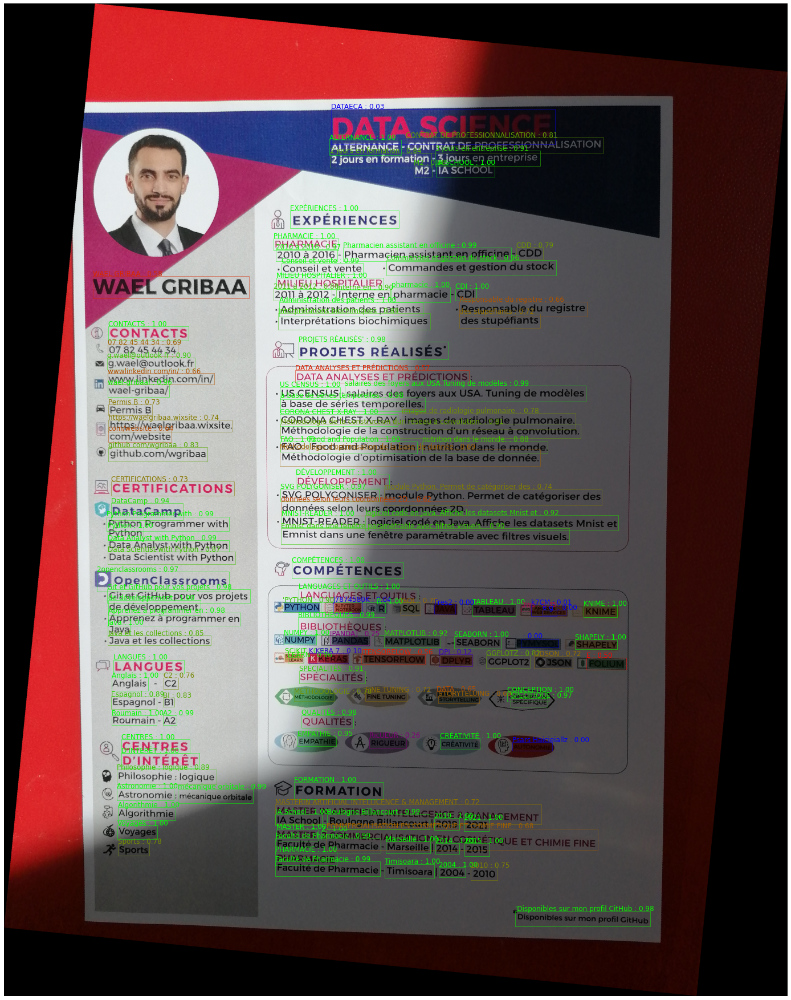

In [ ]:
best_fine_newformula = best_fine_rotation(diff_img, pred_diff_img, show_each = False)

In [ ]:
with open("easyocr_best_rotation_result.pickle", "wb") as f:
    pickle.dump(best_fine_newformula[2], f)